In [1]:
!pip install torch==2.2
!pip install torch_geometric==2.4.0
!pip install seaborn==0.12.2
!pip install networkx==2.8.5
!pip install scikit-learn==1.3.2
!pip install matplotlib==3.5.2
!pip install pandas==1.4.3

  Using cached matplotlib-3.5.2.tar.gz (35.2 MB)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [699 lines of output]
      /private/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/pip-install-8xp2p4bo/matplotlib_6ecff6eaa132422884419c44f23e98e5/setup.py:70: SetuptoolsDeprecationWarning: The test command is disabled and references to it are deprecated.
      !!
      
              ********************************************************************************
              Please remove any references to `setuptools.command.test` in all supported versions of the affected package.
      
              This deprecation is overdue, please update your project and remove deprecated
              calls to avoid build errors in the future.
              ********************************************************************************
      
      !!
        class NoopTestComman

In [3]:
import os
import torch
import numpy as np
import pandas as pd
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

import torch
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import GATConv
from torch_geometric.utils import to_networkx
from torch_geometric.datasets import Planetoid

In [5]:
def visualize(data, labels):
    tsne = TSNE(n_components=2, init='pca', random_state=7)
    tsne_res = tsne.fit_transform(data)
    v = pd.DataFrame(data,columns=[str(i) for i in range(data.shape[1])])
    v['color'] = labels
    v['label'] = v['color'].apply(lambda i: str(i))
    v["dim1"] = tsne_res[:,0]
    v["dim2"] = tsne_res[:,1]
    
    plt.figure(figsize=(12,12))

    sns.scatterplot(
        x="dim1", y="dim2",
        hue="color",
        palette=sns.color_palette(["#52D1DC", "#8D0004", "#845218","#563EAA", "#E44658", "#63C100", "#FF7800"]),
        legend=False,
        data=v,
    )

In [7]:
def visualize_graph(G, color):
    plt.figure(figsize=(75,75))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.arf_layout(G), with_labels=False,
                     node_color=color, cmap="rainbow")
    plt.show()

In [9]:
from torch_geometric.datasets import EllipticBitcoinDataset

In [15]:
dataset = EllipticBitcoinDataset(root='data/EllipticBitcoinDataset')

In [17]:
print(f'Dataset: {dataset}:')
print('======================')
print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')

Dataset: EllipticBitcoinDataset():
Number of graphs: 1
Number of features: 165
Number of classes: 2


In [19]:
data = dataset[0]

In [21]:
print(data)
print('==============================================================')

# Gather some statistics about the graph.
print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(f'Average node degree: {data.num_edges / data.num_nodes:.2f}')
print(f'Number of training nodes: {data.train_mask.sum()}')
print(f'Training node label rate: {int(data.train_mask.sum()) / data.num_nodes:.2f}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')
print(f'Has self-loops: {data.has_self_loops()}')
print(f'Is undirected: {data.is_undirected()}')

Data(x=[203769, 165], edge_index=[2, 234355], y=[203769], train_mask=[203769], test_mask=[203769])
Number of nodes: 203769
Number of edges: 234355
Average node degree: 1.15
Number of training nodes: 29894
Training node label rate: 0.15
Has isolated nodes: False
Has self-loops: False
Is undirected: False


In [23]:
pd.value_counts(data.y.numpy())

2    157205
0     42019
1      4545
dtype: int64

In [25]:
data.train_mask.sum() + data.test_mask.sum()

tensor(46564)

In [27]:
data.y[data.train_mask].sum() + data.y[data.test_mask].sum()

tensor(4545)

In [13]:
# Ensure `train_mask` exists and is a Boolean tensor
train_mask = data.train_mask.bool()

# Determine the number of training nodes
train_indices = train_mask.nonzero(as_tuple=True)[0]

# Shuffle the training indices for random splitting
train_indices = train_indices[torch.randperm(train_indices.size(0))]

# Define the size of the validation set (e.g., 20% of the training nodes)
val_size = int(0.2 * len(train_indices))

# Split the training indices into validation and new training sets
val_indices = train_indices[:val_size]
new_train_indices = train_indices[val_size:]

# Create new masks for training and validation
new_train_mask = torch.zeros_like(train_mask)
new_val_mask = torch.zeros_like(train_mask)

new_train_mask[new_train_indices] = True
new_val_mask[val_indices] = True

# Update the data object with the new masks
data.train_mask = new_train_mask
data.val_mask = new_val_mask

# Verify the sizes of the new masks
print("Training nodes:", new_train_mask.sum().item())
print("Validation nodes:", new_val_mask.sum().item())
print("Testing nodes:", data.test_mask.sum().item())

Training nodes: 23916
Validation nodes: 5978
Testing nodes: 16670


In [14]:
data.subgraph(subset=val_indices)

Data(x=[5978, 165], edge_index=[2, 993], y=[5978], train_mask=[5978], test_mask=[5978], val_mask=[5978])

In [15]:
def visualize_graph(G, color):
    plt.figure(figsize=(60,60))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.random_layout(G), with_labels=False,
                     node_color=color, cmap="winter_r", arrows=True)
    plt.savefig('foo.svg')
    plt.show()

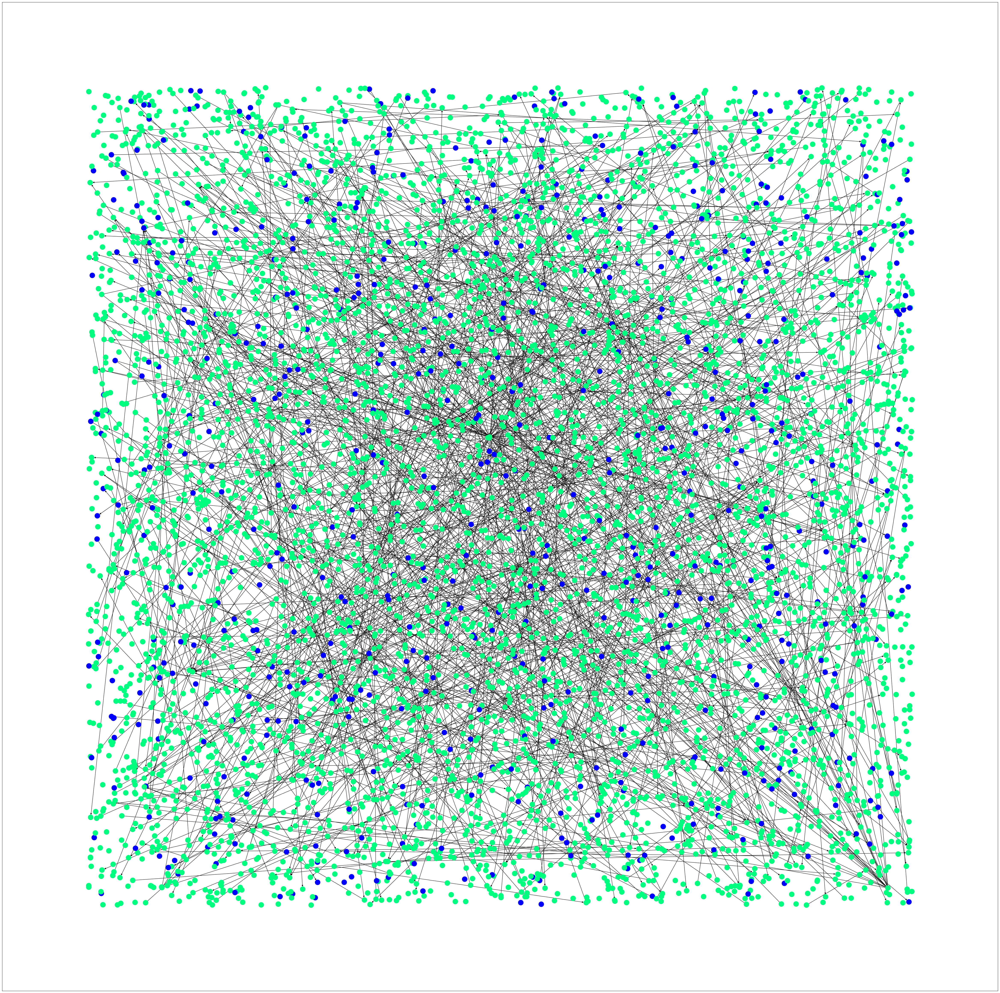

In [16]:
G = to_networkx(data.subgraph(subset=val_indices))
visualize_graph(G, color=data.subgraph(subset=val_indices).y)

In [17]:
NUM_EPOCHS = 1000
LR = 0.01
WDECAY = 1e-4

In [18]:
class MLP(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(12345)
        self.lin1 = Linear(dataset.num_features, hidden_channels)
        self.lin2 = Linear(hidden_channels, dataset.num_classes)

    def forward(self, x):
        x = self.lin1(x)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.lin2(x)
        return x

model = MLP(hidden_channels=8)
print(model)

MLP(
  (lin1): Linear(in_features=165, out_features=8, bias=True)
  (lin2): Linear(in_features=8, out_features=2, bias=True)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


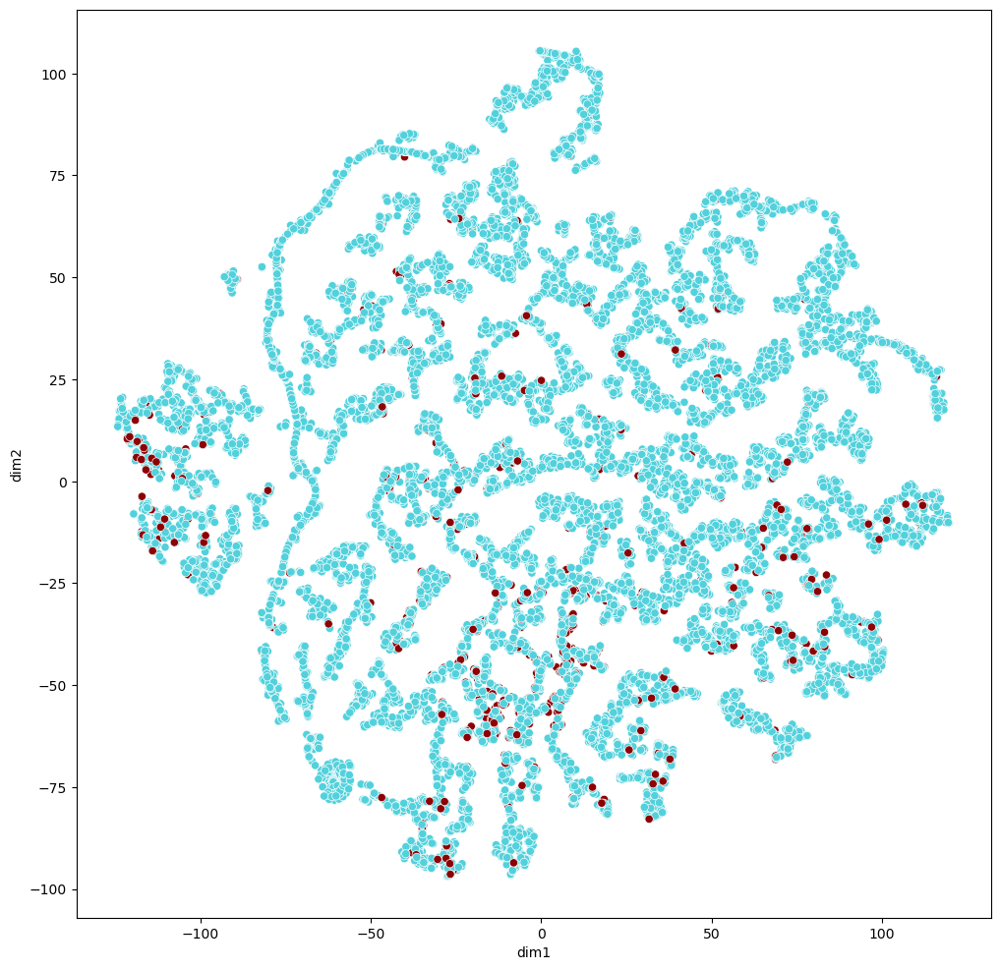

In [19]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

In [20]:
model = MLP(hidden_channels=8)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)  # Define optimizer.

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc

losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 0.8344, Acc: 0.7245
Epoch: 001, Loss: 0.6492, Acc: 0.8265
Epoch: 002, Loss: 0.5656, Acc: 0.8558
Epoch: 003, Loss: 0.5150, Acc: 0.8658
Epoch: 004, Loss: 0.4829, Acc: 0.8750
Epoch: 005, Loss: 0.4579, Acc: 0.8839
Epoch: 006, Loss: 0.4351, Acc: 0.8883
Epoch: 007, Loss: 0.4146, Acc: 0.8941
Epoch: 008, Loss: 0.3994, Acc: 0.8996
Epoch: 009, Loss: 0.3816, Acc: 0.9098
Epoch: 010, Loss: 0.3668, Acc: 0.9139
Epoch: 011, Loss: 0.3546, Acc: 0.9217
Epoch: 012, Loss: 0.3445, Acc: 0.9291
Epoch: 013, Loss: 0.3361, Acc: 0.9316
Epoch: 014, Loss: 0.3234, Acc: 0.9319
Epoch: 015, Loss: 0.3200, Acc: 0.9331
Epoch: 016, Loss: 0.3078, Acc: 0.9341
Epoch: 017, Loss: 0.3023, Acc: 0.9354
Epoch: 018, Loss: 0.2938, Acc: 0.9383
Epoch: 019, Loss: 0.2930, Acc: 0.9401
Epoch: 020, Loss: 0.2880, Acc: 0.9415
Epoch: 021, Loss: 0.2810, Acc: 0.9418
Epoch: 022, Loss: 0.2821, Acc: 0.9428
Epoch: 023, Loss: 0.2817, Acc: 0.9430
Epoch: 024, Loss: 0.2761, Acc: 0.9431
Epoch: 025, Loss: 0.2691, Acc: 0.9435
Epoch: 026, 

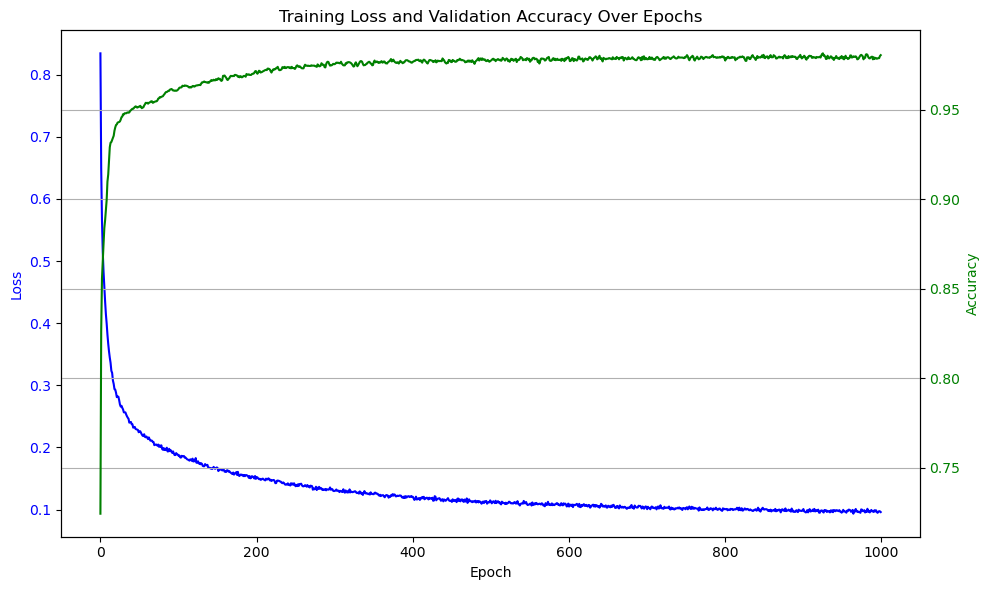

In [21]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [22]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9284


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


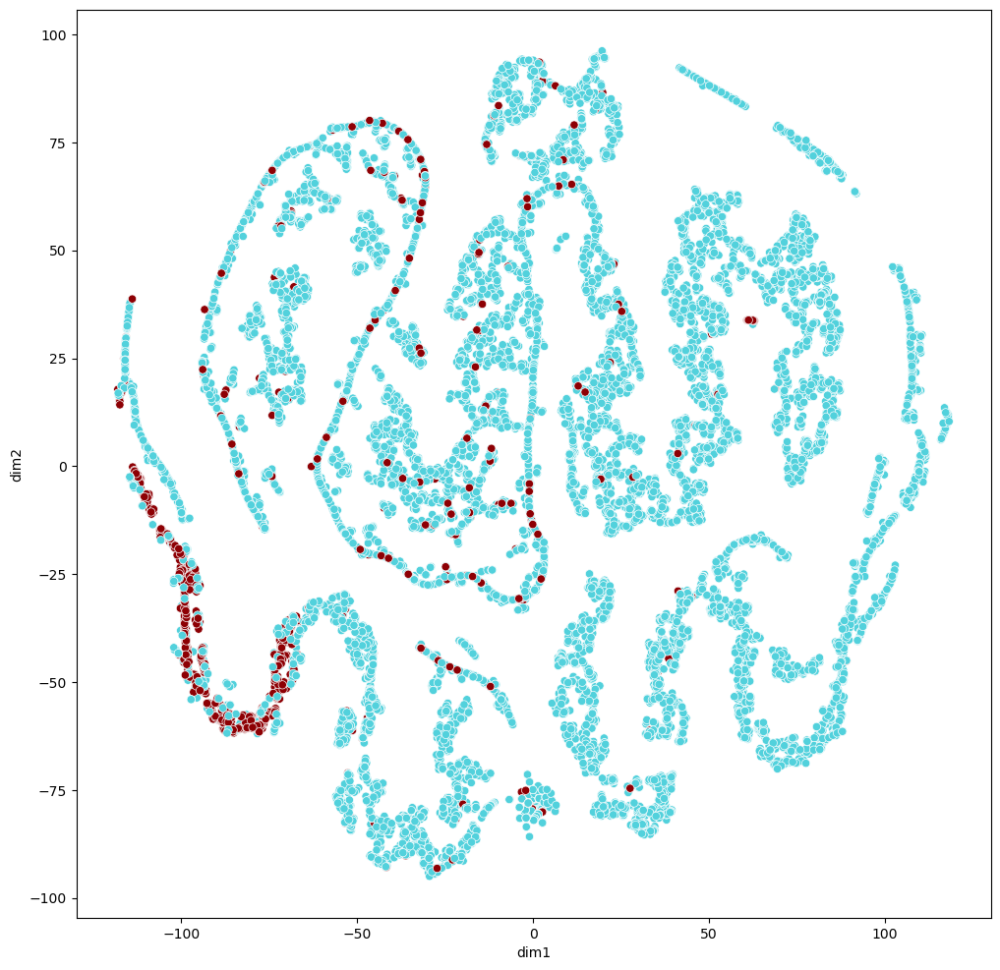

In [23]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

# ========================================

In [25]:
class GCN(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GCNConv(dataset.num_features, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, dataset.num_classes)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GCN(hidden_channels=8)
print(model)

GCN(
  (conv1): GCNConv(165, 8)
  (conv2): GCNConv(8, 2)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


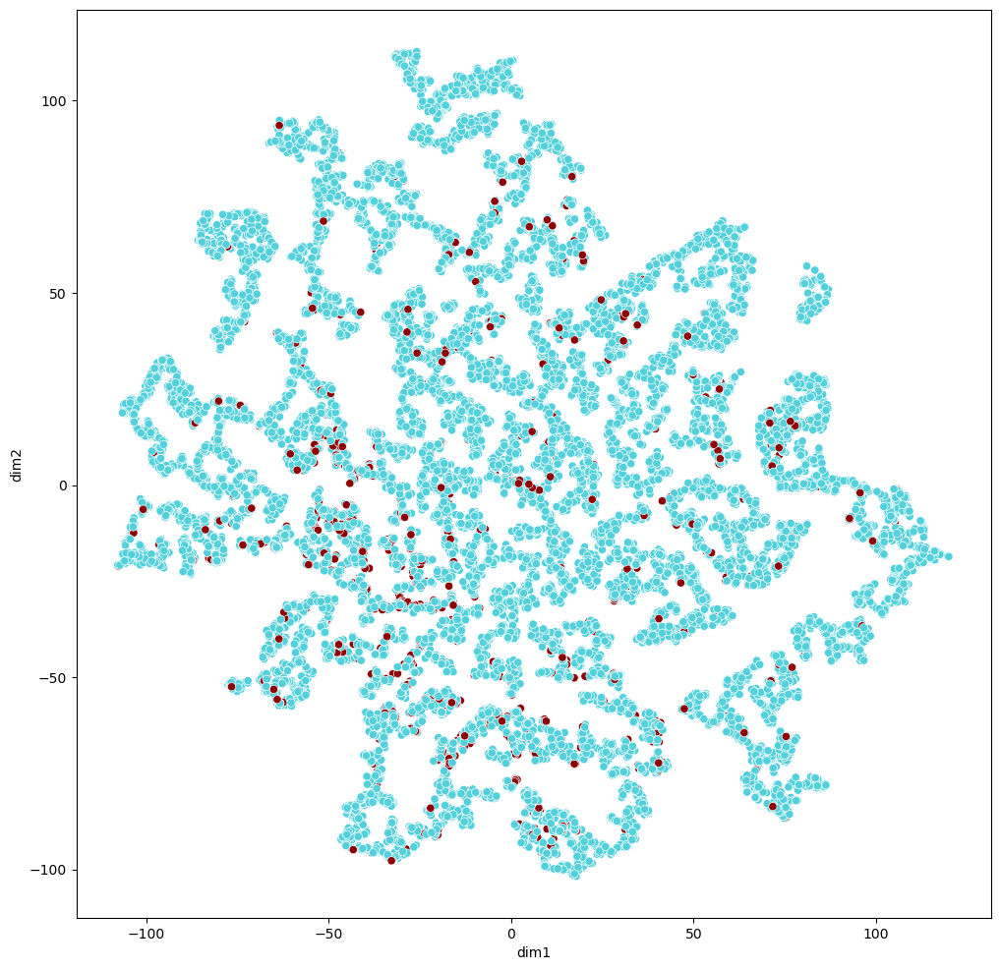

In [26]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [27]:
model = GCN(hidden_channels=8)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x, data.edge_index)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 1.0818, Acc: 0.7840
Epoch: 001, Loss: 0.5794, Acc: 0.8275
Epoch: 002, Loss: 0.4550, Acc: 0.8506
Epoch: 003, Loss: 0.4044, Acc: 0.8667
Epoch: 004, Loss: 0.3642, Acc: 0.8747
Epoch: 005, Loss: 0.3529, Acc: 0.8769
Epoch: 006, Loss: 0.3355, Acc: 0.8787
Epoch: 007, Loss: 0.3215, Acc: 0.8807
Epoch: 008, Loss: 0.3166, Acc: 0.8839
Epoch: 009, Loss: 0.3092, Acc: 0.8886
Epoch: 010, Loss: 0.3072, Acc: 0.8918
Epoch: 011, Loss: 0.3014, Acc: 0.8934
Epoch: 012, Loss: 0.2943, Acc: 0.8948
Epoch: 013, Loss: 0.3044, Acc: 0.8970
Epoch: 014, Loss: 0.3004, Acc: 0.8985
Epoch: 015, Loss: 0.2915, Acc: 0.8990
Epoch: 016, Loss: 0.2885, Acc: 0.8998
Epoch: 017, Loss: 0.2858, Acc: 0.9021
Epoch: 018, Loss: 0.2807, Acc: 0.9033
Epoch: 019, Loss: 0.2784, Acc: 0.9038
Epoch: 020, Loss: 0.2730, Acc: 0.9047
Epoch: 021, Loss: 0.2749, Acc: 0.9041
Epoch: 022, Loss: 0.2739, Acc: 0.9040
Epoch: 023, Loss: 0.2692, Acc: 0.9016
Epoch: 024, Loss: 0.2733, Acc: 0.9016
Epoch: 025, Loss: 0.2625, Acc: 0.9015
Epoch: 026, 

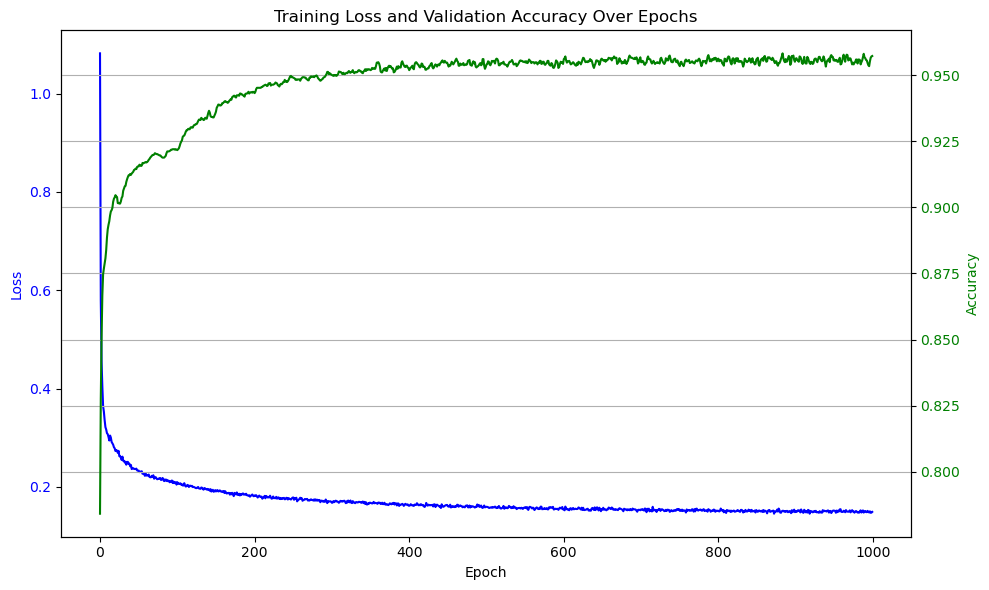

In [28]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [29]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9426


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


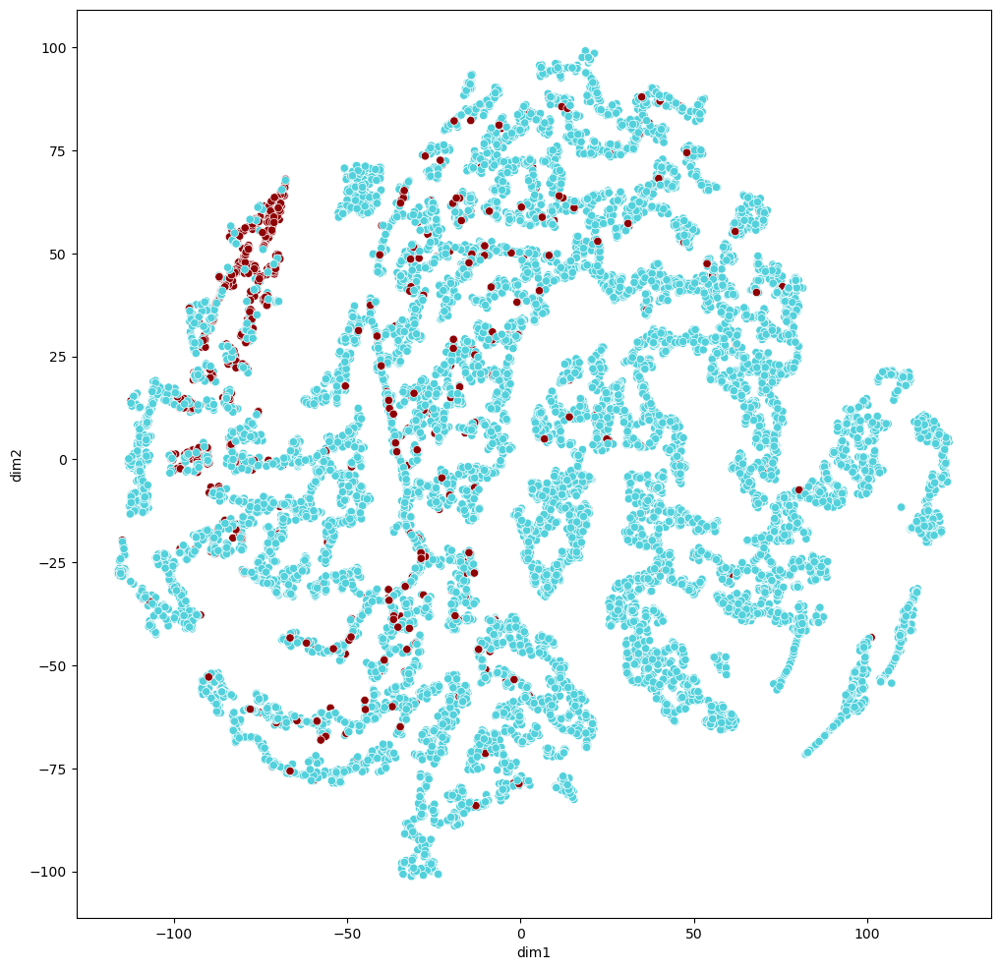

In [30]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)
# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

# ========================================

In [32]:
class GAT(torch.nn.Module):
    def __init__(self, hidden_channels, heads):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GATConv(dataset.num_features, hidden_channels, heads)
        self.conv2 = GATConv(hidden_channels * heads, dataset.num_classes, heads=1)

    def forward(self, x, edge_index):
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GAT(hidden_channels=8, heads=4)
print(model)

GAT(
  (conv1): GATConv(165, 8, heads=4)
  (conv2): GATConv(32, 2, heads=1)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


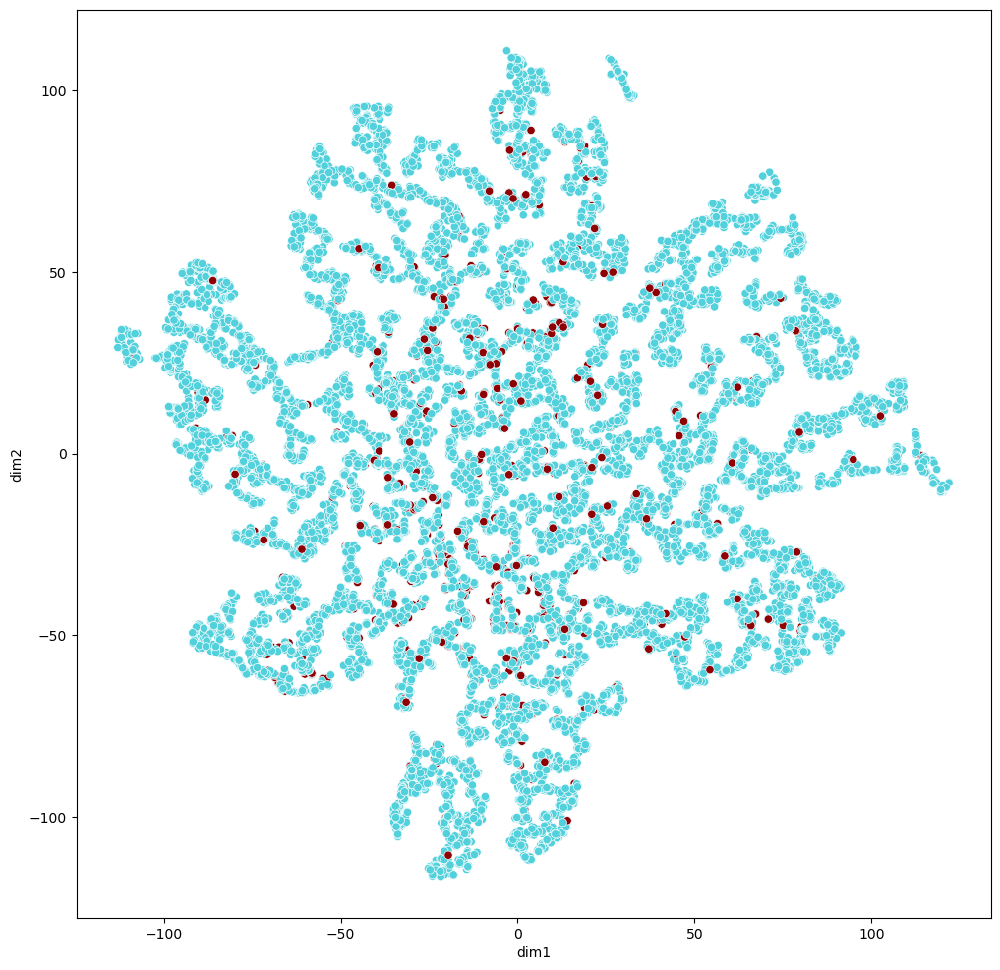

In [33]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [34]:
model = GAT(hidden_channels=8, heads=4)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x, data.edge_index)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 1.6698, Acc: 0.8066
Epoch: 001, Loss: 0.9364, Acc: 0.8628
Epoch: 002, Loss: 0.4805, Acc: 0.8804
Epoch: 003, Loss: 0.4899, Acc: 0.8857
Epoch: 004, Loss: 0.3770, Acc: 0.8874
Epoch: 005, Loss: 0.3715, Acc: 0.8894
Epoch: 006, Loss: 0.3575, Acc: 0.8909
Epoch: 007, Loss: 0.3616, Acc: 0.8970
Epoch: 008, Loss: 0.3623, Acc: 0.9011
Epoch: 009, Loss: 0.3519, Acc: 0.9073
Epoch: 010, Loss: 0.3558, Acc: 0.9100
Epoch: 011, Loss: 0.3550, Acc: 0.9122
Epoch: 012, Loss: 0.3386, Acc: 0.9145
Epoch: 013, Loss: 0.3220, Acc: 0.9167
Epoch: 014, Loss: 0.3168, Acc: 0.9199
Epoch: 015, Loss: 0.3107, Acc: 0.9222
Epoch: 016, Loss: 0.2951, Acc: 0.9241
Epoch: 017, Loss: 0.2891, Acc: 0.9274
Epoch: 018, Loss: 0.2819, Acc: 0.9294
Epoch: 019, Loss: 0.2815, Acc: 0.9296
Epoch: 020, Loss: 0.2752, Acc: 0.9331
Epoch: 021, Loss: 0.2657, Acc: 0.9341
Epoch: 022, Loss: 0.2623, Acc: 0.9351
Epoch: 023, Loss: 0.2617, Acc: 0.9358
Epoch: 024, Loss: 0.2575, Acc: 0.9353
Epoch: 025, Loss: 0.2534, Acc: 0.9353
Epoch: 026, 

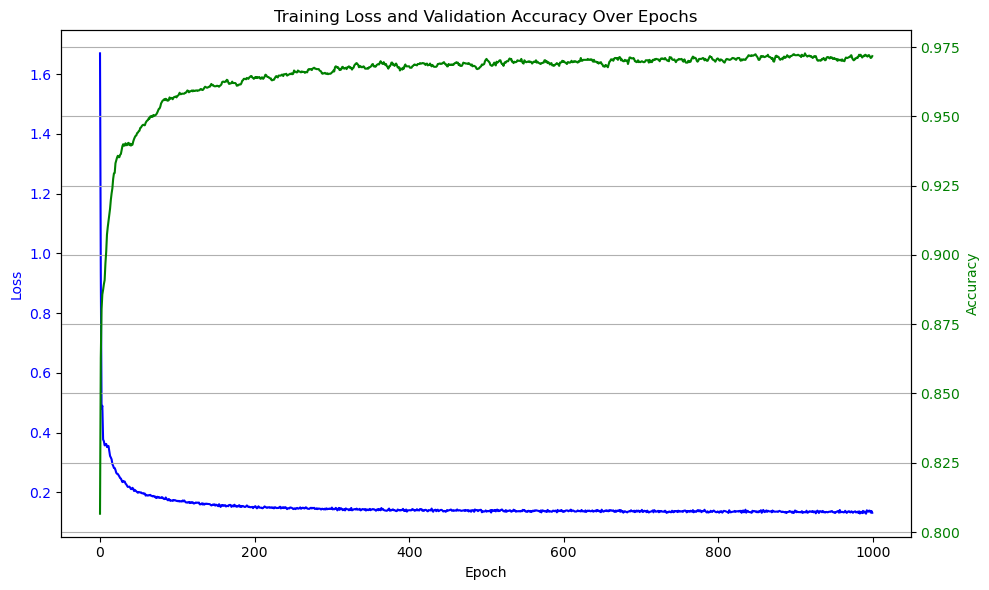

In [35]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [36]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9470


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_10551/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


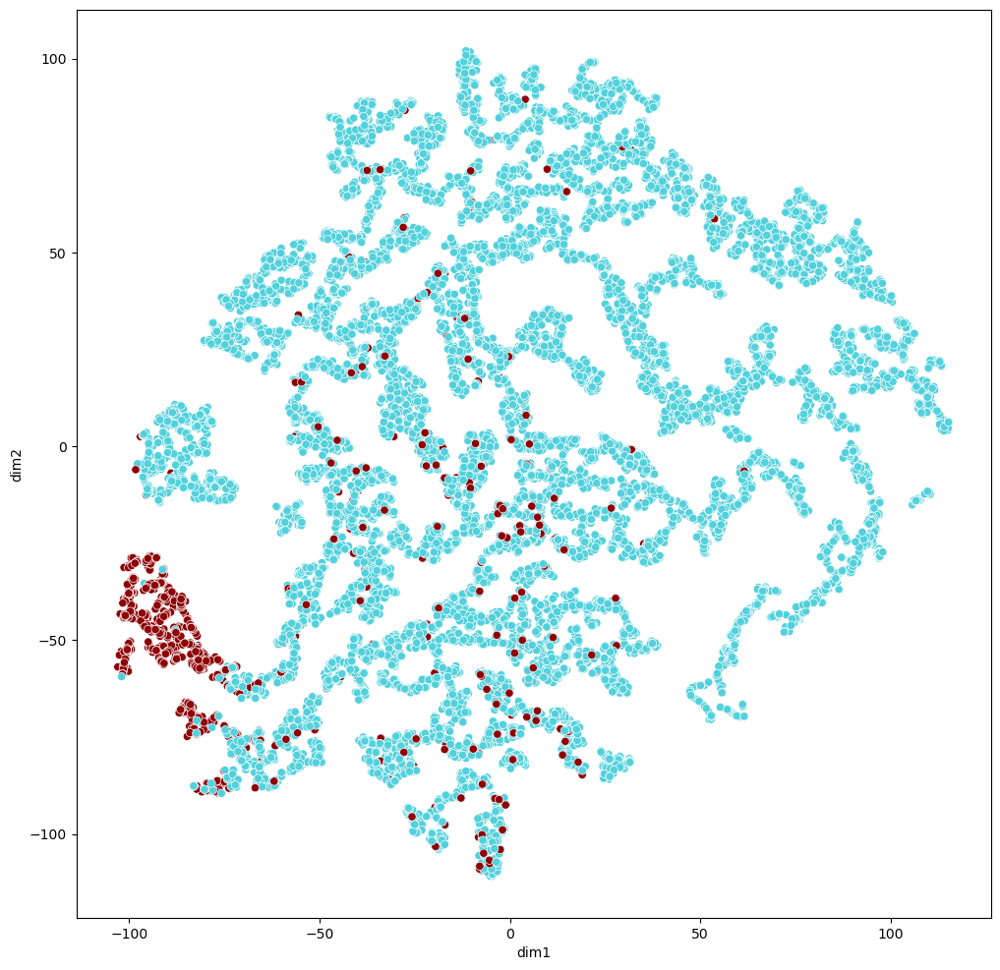

In [37]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)